<h1>1. Business Problem </h1>

<h2> 

Founded in 2000 by a high school teacher in the Bronx, DonorsChoose.org empowers public school teachers from across the country to request much-needed materials and experiences for their students. At any given time, there are thousands of classroom requests that can be brought to life with a gift of any amount

DonorsChoose.org receives hundreds of thousands of project proposals each year for classroom projects in need of funding. Right now, a large number of volunteers is needed to manually screen each submission before it's approved to be posted on the DonorsChoose.org website.

Next year, DonorsChoose.org expects to receive close to 500,000 project proposals. As a result, there are three main problems they need to solve:

How to scale current manual processes and resources to screen 500,000 projects so that they can be posted as quickly and as efficiently as possible

How to increase the consistency of project vetting across different volunteers to improve the experience for teachers

How to focus volunteer time on the applications that need the most assistance

The goal of the competition is to predict whether or not a DonorsChoose.org project proposal submitted by a teacher will be approved, using the text of project descriptions as well as additional metadata about the project, teacher, and school. DonorsChoose.org can then use this information to identify projects most likely to need further review before approval.

With an algorithm to pre-screen applications, DonorsChoose.org can auto-approve some applications quickly so that volunteers can spend their time on more nuanced and detailed project ​vetting processes, including doing more to help teachers develop projects that qualify for specific funding opportunities.

Your machine learning algorithm can help more teachers get funded more quickly, and with less cost to DonorsChoose.org, allowing them to channel even more funding directly to classrooms across the country.

</h2>

<h2> 1.1 Real World / Business Objectives and Constraints </h2>


**A. No latency constraint:**  

**B. Model interpretability important:**


<h1>2. Machine Learning problem </h1>

<h2> 2.1 Data </h2>

<h3> 2.1.1 Data Overview </h3>

<h3> 
Data fields

The files consist of a list of product listings. These files are tab-delimited.

** project essay dataset ** 

* id - unique id of the project application
* teacher_id - id of the teacher submitting the application
* teacher_prefix - title of the teacher's name (Ms., Mr., etc.)
* school_state - US state of the teacher's school
* project_submitted_datetime - application submission timestamp
* project_grade_category - school grade levels (PreK-2, 3-5, 6-8, and 9-12)
* project_subject_categories - category of the project (e.g., "Music & The Arts")
* project_subject_subcategories - sub-category of the project (e.g., "Visual Arts")
* project_title - title of the project
* project_essay_1 - first essay*
* project_essay_2 - second essay*
* project_essay_3 - third essay*
* project_essay_4 - fourth essay*
* project_resource_summary - summary of the resources needed for the project
* teacher_number_of_previously_posted_projects - number of previously posted * applications by the submitting teacher
* project_is_approved - whether DonorsChoose proposal was accepted (0="rejected", 1="accepted"); train.csv only
* Note: Prior to May 17, 2016, the prompts for the essays were as follows:

* project_essay_1: "Introduce us to your classroom"
* project_essay_2: "Tell us more about your students"
* project_essay_3: "Describe how your students will use the materials you're requesting"
* project_essay_4: "Close by sharing why your project will make a difference" 

** Resource dataset **

Proposals also include resources requested. Each project may include multiple requested resources. Each row in resources.csv corresponds to a resource, so multiple rows may tie to the same project by id.

* id - unique id of the project application; joins with test.csv. and train.csv on id
* description - description of the resource requested
* quantity - quantity of resource requested
* price - price of resource requested

 </h3>

Refer: https://www.kaggle.com/c/donorschoose-application-screening/overview/evaluation

<h2>2.2 Mapping the real-world problem to a Machine Learning Problem </h2>

<h3> 2.2.1 Type of Machine Learning Problem </h3>

<p> It is a classification problem  <br>

<h3>2.2.2 Performance metric </h3>

<p> The goal of this competition is to predict whether an application to DonorsChoose is accepted. Submissions are evaluated on area under the ROC curve between the predicted probability and the observed target. <br>




In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install wordcloud

In [ ]:
%matplotlib inline
import numpy as np 
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')

from sklearn.linear_model import LinearRegression 
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import Ridge, Lasso
from sklearn.model_selection import KFold
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from math import sqrt
from sklearn import metrics
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno
import matplotlib.pyplot as plt
import pandas as pd 
import datetime 
import time 
import numpy as np
import matplotlib
matplotlib.use('nbagg')
import matplotlib.pylab as plt
import seaborn as sns
from matplotlib import rcParams
from mlxtend.feature_selection import SequentialFeatureSelector as sfs
from sklearn.linear_model import LinearRegression 
from scipy import stats
import scipy
import math
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.preprocessing import LabelBinarizer
%matplotlib inline
import warnings 
warnings.filterwarnings("ignore") 


In [ ]:
project_data = pd.read_csv('/content/drive/MyDrive/6_Donors_choose_NB/train_data.csv')

In [ ]:
project_data.head()

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,project_submitted_datetime,project_grade_category,project_subject_categories,project_subject_subcategories,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,Mrs.,IN,2016-12-05 13:43:57,Grades PreK-2,Literacy & Language,"ESL, Literacy",Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",NaN,NaN,My students need opportunities to practice beg...,0,0
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,Mr.,FL,2016-10-25 09:22:10,Grades 6-8,"History & Civics, Health & Sports","Civics & Government, Team Sports",Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,NaN,NaN,My students need a projector to help with view...,7,1
2,21895,p182444,3465aaf82da834c0582ebd0ef8040ca0,Ms.,AZ,2016-08-31 12:03:56,Grades 6-8,Health & Sports,"Health & Wellness, Team Sports",Soccer Equipment for AWESOME Middle School Stu...,"\r\n\""True champions aren't always the ones th...",The students on the campus come to school know...,NaN,NaN,"My students need shine guards, athletic socks,...",1,0
3,45,p246581,f3cb9bffbba169bef1a77b243e620b60,Mrs.,KY,2016-10-06 21:16:17,Grades PreK-2,"Literacy & Language, Math & Science","Literacy, Mathematics",Techie Kindergarteners,I work at a unique school filled with both ESL...,My students live in high poverty conditions wi...,NaN,NaN,My students need to engage in Reading and Math...,4,1
4,172407,p104768,be1f7507a41f8479dc06f047086a39ec,Mrs.,TX,2016-07-11 01:10:09,Grades PreK-2,Math & Science,Mathematics,Interactive Math Tools,Our second grade classroom next year will be m...,"For many students, math is a subject that does...",NaN,NaN,My students need hands on practice in mathemat...,1,1


In [ ]:
project_data.shape

(109248, 17)

In [ ]:
project_data.isnull().sum()

Unnamed: 0                                           0
id                                                   0
teacher_id                                           0
teacher_prefix                                       3
school_state                                         0
project_submitted_datetime                           0
project_grade_category                               0
project_subject_categories                           0
project_subject_subcategories                        0
project_title                                        0
project_essay_1                                      0
project_essay_2                                      0
project_essay_3                                 105490
project_essay_4                                 105490
project_resource_summary                             0
teacher_number_of_previously_posted_projects         0
project_is_approved                                  0
dtype: int64

In [ ]:
resource_data = pd.read_csv('/content/drive/MyDrive/6_Donors_choose_NB/resources.csv')

In [ ]:
resource_data.head()

,id,description,quantity,price
0,p233245,LC652 - Lakeshore Double-Space Mobile Drying Rack,1,149.00
1,p069063,Bouncy Bands for Desks (Blue support pipes),3,14.95
2,p069063,Cory Stories: A Kid's Book About Living With Adhd,1,8.45
3,p069063,"Dixon Ticonderoga Wood-Cased #2 HB Pencils, Bo...",2,13.59
4,p069063,EDUCATIONAL INSIGHTS FLUORESCENT LIGHT FILTERS...,3,24.95


In [ ]:
resource_data.shape

(1541272, 4)

In [ ]:
resource_data.isnull().sum()

id               0
description    292
quantity         0
price            0
dtype: int64

#### Concat resource data with project data to do more analysis

In [ ]:
resource_data['price'].value_counts()

29.99     29890
19.99     24729
9.99      21408
49.99     20916
14.99     19429
          ...  
454.94        1
181.46        1
153.77        1
445.43        1
451.19        1
Name: price, Length: 26890, dtype: int64

In [ ]:
price_data = resource_data.groupby('id').agg({'price':'sum', 'quantity': 'sum'}).reset_index()
price_data.head(3)

,id,price,quantity
0,p000001,459.56,7
1,p000002,515.89,21
2,p000003,298.97,4


In [ ]:
project_data = pd.merge(project_data, price_data, on='id', how='left')
project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,project_submitted_datetime,project_grade_category,project_subject_categories,project_subject_subcategories,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,price,quantity
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,Mrs.,IN,2016-12-05 13:43:57,Grades PreK-2,Literacy & Language,"ESL, Literacy",Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",NaN,NaN,My students need opportunities to practice beg...,0,0,154.6,23
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,Mr.,FL,2016-10-25 09:22:10,Grades 6-8,"History & Civics, Health & Sports","Civics & Government, Team Sports",Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,NaN,NaN,My students need a projector to help with view...,7,1,299.0,1


#### Text Analysis

#### project essay

In [ ]:
project_data['essay'] = project_data['project_essay_1'].map(str)+project_data['project_essay_2'].map(str)+project_data['project_essay_3'].map(str)+project_data['project_essay_4'].map(str)

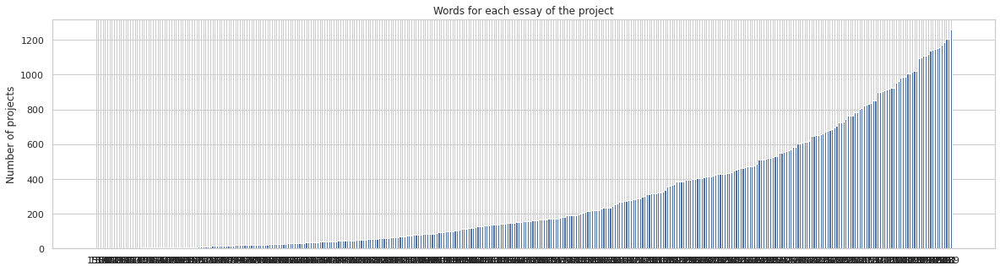

In [ ]:
words_count = project_data['essay'].str.split().apply(len).value_counts()
word_dict = dict(words_count)
word_dict = dict(sorted(word_dict.items(), key=lambda kv: kv[1]))

ind = np.arange(len(word_dict))
plt.figure(figsize=(20,5))
p1 = plt.bar(ind, list(word_dict.values()))

plt.ylabel('Number of projects')
plt.title('Words for each essay of the project')
plt.xticks(ind, list(word_dict.keys()))
plt.show()

Text(0.5, 1.0, 'most frequently occuring essay words - Top 30')

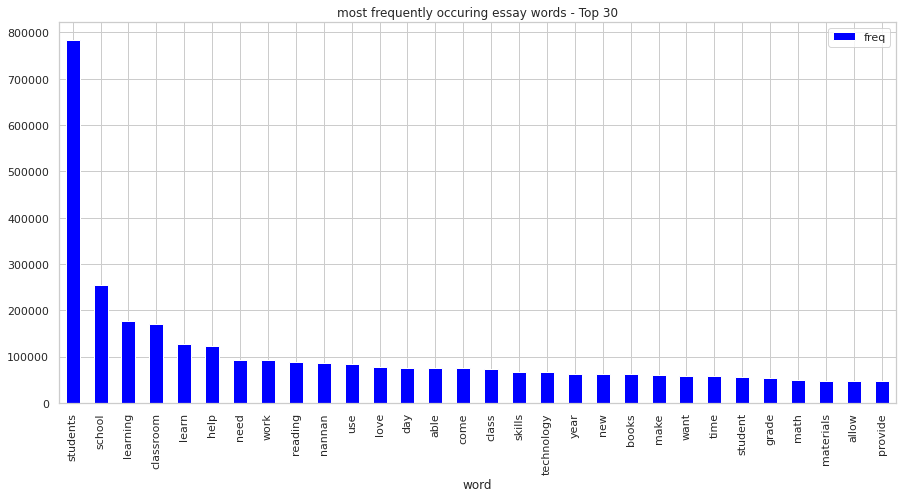

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

cv2 = CountVectorizer(stop_words='english')
words = cv2.fit_transform(project_data.essay)

sum_words = words.sum(axis=0)

words_freq = [(word, sum_words[0,i]) for word, i in cv2.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x:x[1], reverse=True)

frequency = pd.DataFrame(words_freq, columns=['word','freq'])

frequency.head(30).plot(x='word', y='freq', kind='bar', figsize=(15,7), color='blue')
plt.title('most frequently occuring essay words - Top 30')

In [ ]:
type(rejected_essay)

str

In [ ]:
df = pd.DataFrame([x.split(';') for x in rejected_essay.split('\n')])
print(df)

                                                0     ...                                               2198
0  My students are English learners that are work...  ...   that is the true goal of education.\"My stude...

[1 rows x 2199 columns]


In [ ]:
df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2159,2160,2161,2162,2163,2164,2165,2166,2167,2168,2169,2170,2171,2172,2173,2174,2175,2176,2177,2178,2179,2180,2181,2182,2183,2184,2185,2186,2187,2188,2189,2190,2191,2192,2193,2194,2195,2196,2197,2198
0,My students are English learners that are work...,"at our school, we are trying to provide stude...",this impacts their ability to learn through l...,a place where the students look forward to co...,they face many obstacles which they work hard...,that is seen in integrating all students into...,full of life and energy. Just 3 short months ...,"students who are engaged, excited about learn...","each with their own personality, each with th...","this may be academic, language, or social. \...","58 Caucasian students, and 5 Hispanic Student...","the more that you learn, the more places you'...",they work hard towards their goals and as sta...,on weekends they may be helping their familie...,"and in alignment with \""Early Childhood\"" edu...",that is what we are going to share with my st...,we also look at relevant world and community ...,we are currently in our second year. Our stud...,"their school, community, the world and their ...",our job is to shine a light on that genius an...,we are currently in our second year.\r\nOur s...,"their school, community, the world and their ...",our job is to shine a light on that genius an...,with growing confidence in their understandin...,they are 5 after all!) \r\n Coming from a ...,however students are transported from surroun...,for their most successful year yet!Snow man? ...,we will build your inventions so they can be ...,"by printing them! We don't need the \""resourc...","however, adding some creativity and getting s...",getting better each day is all we can expect ...,I can easily see if they are writing in the c...,develop an initial model,test the model with empirical investigations ...,"engage in argumentation as they assess, revis...",and then apply the model to construct explana...,the materials and the play workshop will let ...,"as well as, help prepare them for computer-ba...",and receive free or reduced lunches. My stude...,"however, the desks students have are triangul...",...,due to the restructuring of the distribution...,their safe place. It is where I get to talk w...,so that they too will understand the message ...,"some parents work for FedEx and St Jude, and ...",they tend to come together well to support ea...,"Black, non-Hispanic, and Asian. 100% of the 5...",many of my students spend their time (at home...,and they will also be a great way to motivate...,In the winter it is either too hot or too col...,"some exhibit high levels of truancy, or are c...","and based on surveys and discussions, most ar...",the regular education class teachers forgetti...,"\"" Develop your senses-especially learn how t...",reading their reports on the impact of Downs ...,observing their presentation skills increase ...,topics that most of their parents do not know...,I teach six sections of middle school science...,I hope to adapt this idea to my classroom. B...,94% of the school’s students are economically...,"one in the morning, for lunch, and even extra...",each student needs to perform 100 hours of co...,each graduate needs to be accepted to a colle...,The adidas Team Speed Small Duffel will give ...,that will not only give the phonemic knowledg...,on a wheel. This would allow student to learn...,with your help they can achieve their goals.\...,"writing prompts, exercises, and lessons",poet mentors and performers who visit the sch...,and registration for competing in the annual ...,"however, they are not letting their language ...",I am doing everything I can to help them stay...,"kind, polite, and ready to learn each day! We...",which leads to preventable behavior problems....,they come from the city of Baltimore in which...,also they do not have computers or tablet

In [ ]:
rejected_essay

'My students are English learners that are working on English as their second or third languages. We are a melting pot of refugees, immigrants, and native-born Americans bringing the gift of language to our school. \\r\\n\\r\\n We have over 24 languages represented in our English Learner program with students at every level of mastery.  We also have over 40 countries represented with the families within our school.  Each student brings a wealth of knowledge and experiences to us that open our eyes to new cultures, beliefs, and respect.\\"The limits of your language are the limits of your world.\\"-Ludwig Wittgenstein  Our English learner\'s have a strong support system at home that begs for more resources.  Many times our parents are learning to read and speak English along side of their children.  Sometimes this creates barriers for parents to be able to help their child learn phonetics, letter recognition, and other reading skills.\\r\\n\\r\\nBy providing these dvd\'s and players, st

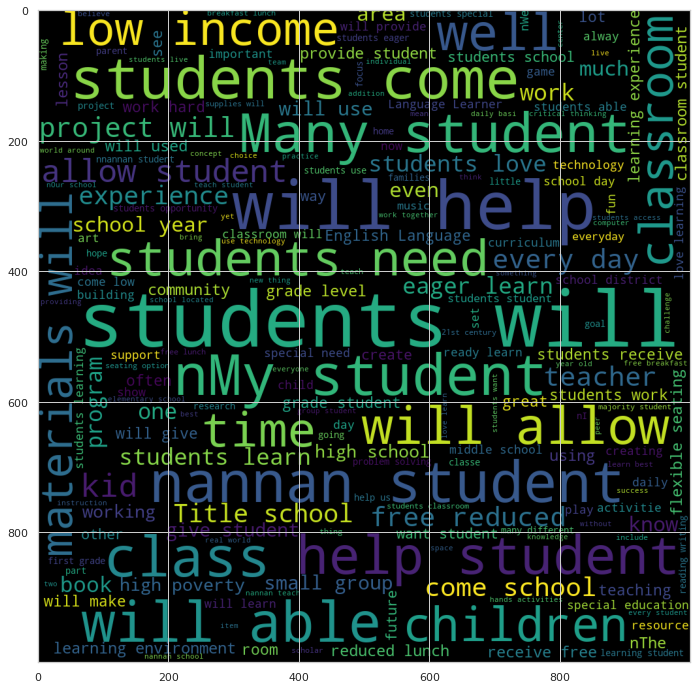

In [ ]:
rejected_essay = " ".join([text for text in project_data['essay'][project_data['project_is_approved'] == 0]])

wordcloud = WordCloud(background_color = 'black', width = 1000, height = 1000).generate(rejected_essay)

plt.figure(figsize=(14,12))
plt.imshow(wordcloud)
plt.show("WordCloud - Rejected projects with most frequent words in essay")

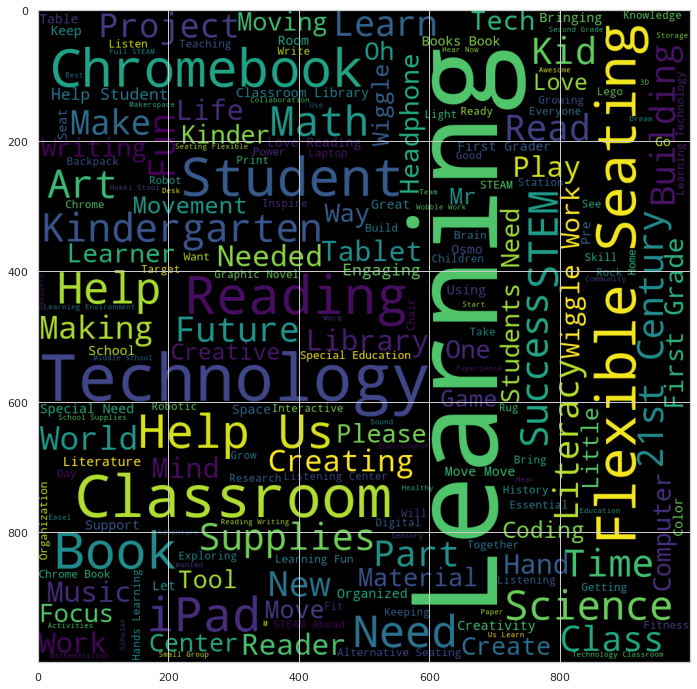

In [ ]:
accepted_essay = " ".join([text for text in project_data['project_title'][project_data['project_is_approved'] == 1]])

wordcloud = WordCloud(background_color = 'black', width = 1000, height = 1000).generate(accepted_essay)

plt.figure(figsize=(14,12))
plt.imshow(wordcloud)
plt.show("WordCloud - Accepted projects with most frequent words in essay")

In [ ]:
approved_word_count_essay = project_data[project_data['project_is_approved']==1]['essay'].str.split().apply(len)
approved_word_count_essay = approved_word_count_essay.values

rejected_word_count_essay = project_data[project_data['project_is_approved']==0]['essay'].str.split().apply(len)
rejected_word_count_essay = rejected_word_count_essay.values

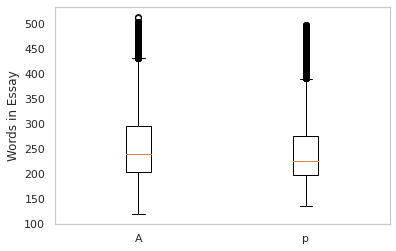

In [ ]:
plt.boxplot([approved_word_count_essay, rejected_word_count_essay])
plt.xticks([1,2],('Approved projects, Rejected Projects'))
plt.ylabel('Words in Essay')
plt.grid()
plt.show()

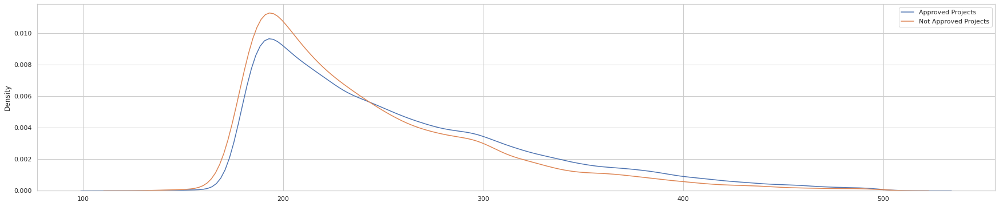

In [ ]:
plt.figure(figsize=(30,6))
sns.distplot(approved_word_count_essay, hist=False, label="Approved Projects")
sns.distplot(rejected_word_count_essay, hist=False, label="Not Approved Projects")
plt.legend()
plt.show()